<a href="https://colab.research.google.com/github/UFPE-ProjetoAM/AM-Questao01/blob/main/fou_KFCM_W_2_ipynb_Dataset_fou.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [71]:
!pip install imgkit
!apt-get install -y wkhtmltopdf

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
wkhtmltopdf is already the newest version (0.12.6-2).
0 upgraded, 0 newly installed, 0 to remove and 18 not upgraded.


In [72]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist
from sklearn.metrics import adjusted_rand_score as ARI
from sklearn import datasets
from sklearn.datasets import load_iris
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from google.colab import drive
from sklearn.metrics import confusion_matrix
import seaborn as sns
from matplotlib.pyplot import figure
from sklearn.metrics import (confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, RocCurveDisplay, det_curve, auc)
from decimal import Decimal, getcontext
from matplotlib.colors import BoundaryNorm
import matplotlib.pyplot as plt
import imgkit
from IPython.display import Image

In [73]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [74]:
#Gabi
data = pd.read_csv('/content/drive/MyDrive/Datasets/mfeat-fou', header=None,delim_whitespace=True)
label= pd.read_csv('/content/drive/MyDrive/Datasets/label.csv', header=None,delim_whitespace=True)

In [75]:
#Dataset dos números

X1=data.to_numpy()
scaler = StandardScaler()
X = scaler.fit_transform(X1)

In [76]:
import numpy as np

class KFCM_K_W2:
    def __init__(self, data, c=10, m=1.1, max_iter=100, tol=1e-5):
        self.data = data
        self.c = c
        self.m = m
        self.n, self.p = data.shape
        self.U = np.zeros((self.c, self.n))
        self.g = np.zeros((self.c, self.p))
        self.s = np.ones((self.c, self.p))
        self.max_iter = max_iter
        self.tol = tol

    def gaussian_kernel(self, x, g, s):
        return np.exp(-0.5 * (np.sum((x - g)**2 * s, axis=1)))

    def initialize(self):
        self.U = np.random.rand(self.c, self.n)
        self.U /= self.U.sum(axis=0)
        idx = np.random.choice(self.n, self.c, replace=False)
        self.g = self.data[idx]
        return self.U, self.g
#Eq.15b
    def compute_prototypes(self):
        for i in range(self.c):
            kernel_values = self.gaussian_kernel(self.data, self.g[i], self.s[i])
            U_powered = self.U[i] ** self.m
            #Equação 8b
            self.g[i] = np.sum((U_powered * kernel_values)[:, None] * self.data, axis=0) / np.sum(U_powered * kernel_values)
        return self.g
#eq.14b
    def compute_widths(self):
      self.s = np.zeros((self.c, self.p), dtype=np.float64)
      for i in range(self.c):
          # Calcula o kernel para cada ponto de dados uma vez para evitar repetição
          kernel_values = self.gaussian_kernel(self.data, self.g[i], self.s[i])
          U_powered = self.U[i] ** self.m
          # Multiplica U_powered com kernel_values sem criar um array temporário grande
          U_powered_kernel = U_powered * kernel_values

          # Calcula o numerador e o denominador sem usar operações de potência ou produto
          for j in range(self.p):
              diffs_squared = (self.data[:, j] - self.g[i, j]) ** 2
              numerator = np.sum(U_powered_kernel * diffs_squared)
              denominator = np.sum(U_powered_kernel)
              self.s[i, j] = numerator / denominator

          # Aplica a transformação final em s[i] sem usar np.prod
          s_i_product = np.prod(self.s[i])
          self.s[i] = self.s[i] ** (1.0 / self.p) / s_i_product

      # Normaliza s para ter o produto dos elementos de cada linha igual a 1
      self.s = self.s / np.linalg.norm(self.s, ord=1, axis=1, keepdims=True)

      return self.s

#Eq.16
    def compute_JNew(self):
        J = 0
        for i in range(self.c):
            kernel_values = self.gaussian_kernel(self.data, self.g[i], self.s[i])
            J += np.sum((self.U[i]**self.m) * (2 - 2 * kernel_values))
        return J
#Eq.13
    def update_membership(self):
      epsilon = 1e-10
      for k in range(self.n):
          for i in range(self.c):
              kernel_values = self.gaussian_kernel(np.tile(self.data[k], (self.c, 1)), self.g, self.s)
              sum_denominator = np.sum((1 - kernel_values) / ((1 - kernel_values[i]) + epsilon), axis=0)
              self.U[i, k] = 1 / (sum_denominator ** (1 / (self.m - 1)))

      # Normalizar cada coluna de U para que a soma seja 1
      self.U /= np.sum(self.U, axis=0, keepdims=True)
      return self.U


    def fit(self):
        U, g = self.initialize()
        J_old = np.inf
        contador = 1
        for iter_count in range(self.max_iter):
            uik = self.update_membership()
            S = self.compute_widths()
            gi = self.compute_prototypes()
            J_new = self.compute_JNew()
            if abs(J_new - J_old) < self.tol:
                break
            J_old = J_new
            contador += 1

***********************
Épocas:  0
Função de custo:  1501.5129091571662
----------------
Parâmetros de Largura s:  [[0.01313658 0.01324445 0.01320244 0.01322763 0.01324662 0.01318562
  0.01319866 0.01317208 0.01318262 0.01312842 0.01312813 0.01319093
  0.01313738 0.01320235 0.01316116 0.0131709  0.01314405 0.01311121
  0.01316874 0.01314668 0.01316462 0.01316959 0.01312318 0.01313903
  0.01316356 0.01316103 0.01314021 0.01313542 0.01314644 0.01316946
  0.01316057 0.01315564 0.01312897 0.01314823 0.01316812 0.0131636
  0.01314454 0.01314518 0.01314405 0.01317548 0.01316647 0.01314979
  0.01314027 0.0131372  0.01315793 0.01314621 0.01313809 0.01314095
  0.01316418 0.01313487 0.01313271 0.01313351 0.01315887 0.01313712
  0.01312889 0.01315007 0.01315514 0.01312415 0.01313924 0.01312811
  0.01313887 0.01315746 0.01312706 0.01317791 0.01315613 0.01312951
  0.01313924 0.01315598 0.01310492 0.01317747 0.01315242 0.01323185
  0.01318666 0.01319118 0.01317621 0.01319978]
 [0.01313658 0.01324445

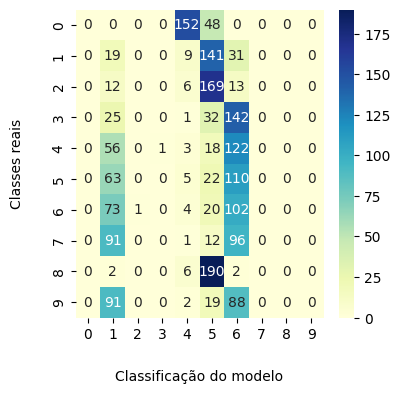

***********************
Épocas:  1
Função de custo:  1507.3030238710005
----------------
Parâmetros de Largura s:  [[0.01313562 0.01325354 0.01320725 0.01323429 0.01325602 0.01318675
  0.01320109 0.01317294 0.01318448 0.0131246  0.013122   0.01319428
  0.01313281 0.0132079  0.01316295 0.01317087 0.01314142 0.01310576
  0.01316775 0.01314516 0.01316462 0.01317117 0.01311799 0.01313851
  0.01316493 0.01316042 0.01313788 0.01313185 0.01314452 0.01317064
  0.01316127 0.01315408 0.01312373 0.01314643 0.01316986 0.01316406
  0.0131428  0.01314257 0.01314161 0.01317791 0.01316782 0.01314887
  0.01313688 0.01313399 0.01315857 0.01314507 0.01313653 0.01314061
  0.01316501 0.01313332 0.01313047 0.01313216 0.01315895 0.01313628
  0.01312664 0.01315093 0.01315501 0.01312256 0.01313863 0.01312708
  0.01313744 0.013159   0.01312458 0.01318308 0.01315514 0.01312954
  0.01313889 0.01315697 0.01309843 0.01318218 0.01315284 0.01323966
  0.01318975 0.01319287 0.01317874 0.01320124]
 [0.01313561 0.0132535

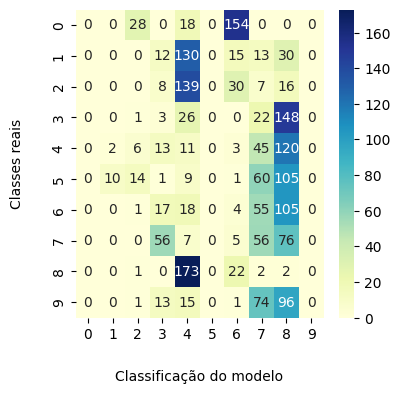

***********************
Épocas:  2
Função de custo:  1507.3057326660614
----------------
Parâmetros de Largura s:  [[0.01314778 0.01307307 0.01308817 0.01310363 0.01307924 0.01314714
  0.01313204 0.01310351 0.01316614 0.01318699 0.0131422  0.01315573
  0.01312961 0.01314847 0.01316497 0.0131583  0.01318492 0.01316446
  0.01316674 0.01318196 0.0131635  0.01316458 0.01317735 0.01318204
  0.01317543 0.01316492 0.01318226 0.01317295 0.01317509 0.01316965
  0.01317115 0.01317133 0.01317601 0.0131747  0.01316947 0.01317046
  0.01317297 0.01317322 0.01317474 0.0131661  0.01317043 0.01317699
  0.01317264 0.01317735 0.01316607 0.01317255 0.01317334 0.0131748
  0.01316874 0.01317478 0.01317272 0.01317428 0.01316209 0.01317801
  0.01317063 0.01317432 0.0131652  0.01318376 0.01316527 0.01317987
  0.01315459 0.01316751 0.01316284 0.0131662  0.01315416 0.01318987
  0.01316093 0.01316224 0.0131535  0.0131459  0.0131521  0.01308233
  0.01309776 0.01311172 0.01316824 0.01304326]
 [0.01314773 0.0130732 

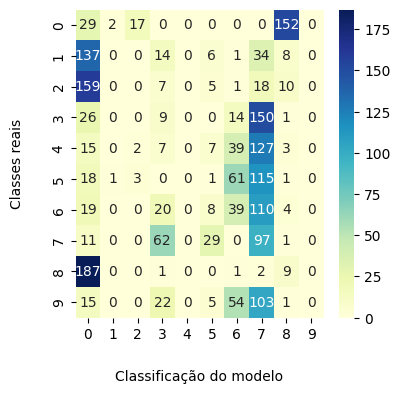

***********************
Épocas:  3
Função de custo:  1507.3023804660652
----------------
Parâmetros de Largura s:  [[0.01314774 0.01307318 0.01308814 0.01310384 0.01307932 0.01314724
  0.01313207 0.01310349 0.0131662  0.01318695 0.01314221 0.01315566
  0.01312961 0.01314832 0.01316498 0.0131583  0.01318482 0.0131644
  0.01316672 0.01318195 0.01316347 0.01316453 0.01317728 0.01318196
  0.01317547 0.0131649  0.01318224 0.01317291 0.01317504 0.01316971
  0.01317113 0.01317132 0.01317595 0.01317463 0.01316949 0.01317047
  0.01317296 0.01317317 0.01317468 0.01316615 0.01317045 0.01317697
  0.01317262 0.0131773  0.01316609 0.01317256 0.01317333 0.01317479
  0.01316877 0.01317478 0.01317271 0.01317428 0.01316211 0.01317799
  0.01317061 0.01317432 0.01316519 0.01318373 0.01316528 0.01317987
  0.01315457 0.01316751 0.01316285 0.01316616 0.01315413 0.01318984
  0.01316094 0.01316227 0.01315351 0.01314596 0.01315218 0.01308232
  0.01309783 0.01311182 0.01316835 0.01304343]
 [0.01314774 0.01307318

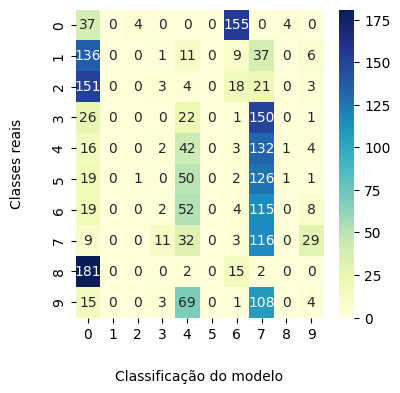

***********************
Épocas:  4
Função de custo:  1507.3011391063553
----------------
Parâmetros de Largura s:  [[0.01313558 0.0132537  0.01320729 0.01323457 0.01325596 0.01318677
  0.0132012  0.01317293 0.01318457 0.01312462 0.01312195 0.01319423
  0.01313277 0.01320787 0.01316291 0.01317088 0.01314141 0.01310569
  0.01316773 0.01314519 0.01316462 0.01317113 0.01311797 0.01313846
  0.01316498 0.01316047 0.01313788 0.0131318  0.01314445 0.01317073
  0.01316132 0.01315406 0.0131237  0.01314639 0.01316996 0.01316413
  0.01314281 0.01314254 0.01314156 0.01317801 0.01316791 0.01314888
  0.01313687 0.01313396 0.01315865 0.01314508 0.01313651 0.01314056
  0.01316508 0.01313331 0.01313043 0.0131321  0.01315901 0.01313626
  0.01312659 0.01315088 0.01315504 0.01312253 0.01313857 0.01312701
  0.01313742 0.01315895 0.01312451 0.01318304 0.01315514 0.01312953
  0.01313885 0.01315693 0.01309837 0.01318214 0.01315277 0.01323959
  0.01318968 0.01319296 0.01317881 0.01320134]
 [0.01314774 0.0130731

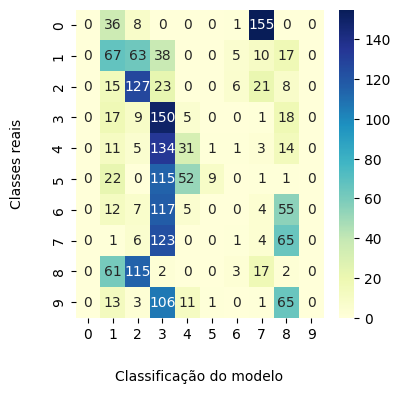

***********************
Épocas:  5
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01313468 0.0132619

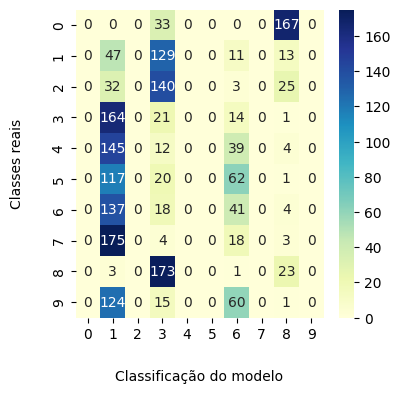

***********************
Épocas:  6
Função de custo:  1507.301366045777
----------------
Parâmetros de Largura s:  [[0.01314774 0.01307318 0.01308815 0.01310384 0.01307932 0.01314724
  0.01313207 0.01310349 0.0131662  0.01318695 0.01314221 0.01315566
  0.01312961 0.01314832 0.01316498 0.0131583  0.01318482 0.0131644
  0.01316672 0.01318195 0.01316347 0.01316453 0.01317728 0.01318196
  0.01317547 0.0131649  0.01318224 0.01317291 0.01317504 0.01316971
  0.01317113 0.01317132 0.01317596 0.01317463 0.01316949 0.01317047
  0.01317296 0.01317318 0.01317468 0.01316615 0.01317046 0.01317697
  0.01317262 0.0131773  0.01316609 0.01317256 0.01317333 0.01317478
  0.01316877 0.01317477 0.01317271 0.01317428 0.01316211 0.01317799
  0.01317061 0.01317432 0.01316519 0.01318372 0.01316528 0.01317987
  0.01315457 0.01316751 0.01316285 0.01316616 0.01315414 0.01318984
  0.01316094 0.01316226 0.0131535  0.01314596 0.01315217 0.01308231
  0.01309783 0.01311181 0.01316835 0.01304342]
 [0.0131356  0.0132536  

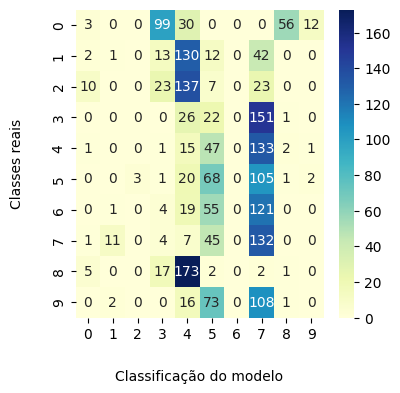

***********************
Épocas:  7
Função de custo:  1507.3008421102222
----------------
Parâmetros de Largura s:  [[0.01313558 0.01325366 0.01320728 0.01323451 0.01325597 0.01318677
  0.01320117 0.01317293 0.01318455 0.01312462 0.01312196 0.01319424
  0.01313278 0.01320788 0.01316292 0.01317088 0.01314141 0.01310571
  0.01316774 0.01314519 0.01316462 0.01317114 0.01311798 0.01313847
  0.01316497 0.01316046 0.01313788 0.01313181 0.01314447 0.01317071
  0.01316131 0.01315406 0.01312371 0.0131464  0.01316994 0.01316412
  0.01314281 0.01314255 0.01314157 0.01317799 0.01316789 0.01314888
  0.01313687 0.01313397 0.01315863 0.01314508 0.01313651 0.01314056
  0.01316506 0.01313331 0.01313044 0.01313211 0.013159   0.01313627
  0.01312659 0.01315089 0.01315503 0.01312254 0.01313857 0.01312702
  0.01313742 0.01315896 0.01312452 0.01318305 0.01315514 0.01312953
  0.01313885 0.01315693 0.01309838 0.01318214 0.01315277 0.01323961
  0.01318968 0.01319294 0.01317879 0.01320132]
 [0.01313556 0.0132537

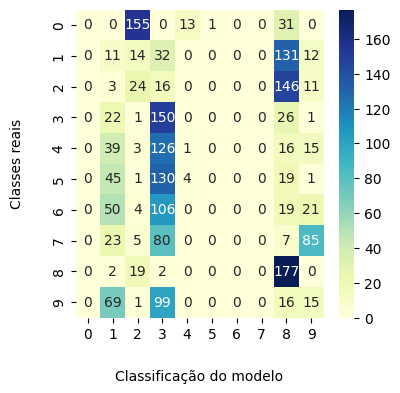

***********************
Épocas:  8
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01314798 0.0130751

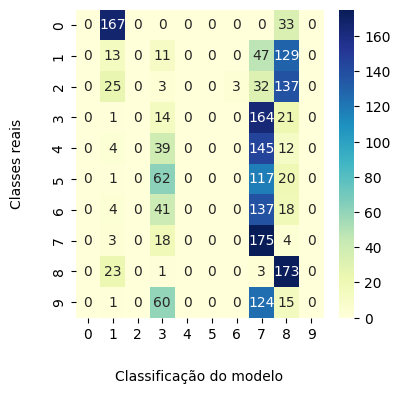

***********************
Épocas:  9
Função de custo:  1513.1483911777898
----------------
Parâmetros de Largura s:  [[0.01313468 0.01326197 0.01321138 0.01324049 0.01326462 0.01318739
  0.01320313 0.01317294 0.01318613 0.0131213  0.0131158  0.01319741
  0.01312806 0.01321307 0.01316487 0.01317049 0.01313969 0.01310093
  0.01316631 0.01314381 0.01316463 0.01317273 0.0131135  0.01313886
  0.01316648 0.01316008 0.01313601 0.01312897 0.01314274 0.01317174
  0.01316216 0.01315271 0.01311907 0.01314511 0.01317159 0.01316463
  0.0131415  0.01314049 0.01313949 0.01318025 0.01316932 0.01314832
  0.013134   0.0131314  0.01315927 0.01314383 0.01313518 0.01314052
  0.01316573 0.013132   0.01312844 0.01313074 0.01315899 0.01313563
  0.01312437 0.01315174 0.01315487 0.01312129 0.0131381  0.01312601
  0.01313609 0.01316054 0.01312201 0.01318815 0.01315387 0.01313023
  0.0131384  0.01315729 0.0130927  0.01318641 0.01315223 0.0132465
  0.01319173 0.01319392 0.01318081 0.01320216]
 [0.01313468 0.01326197

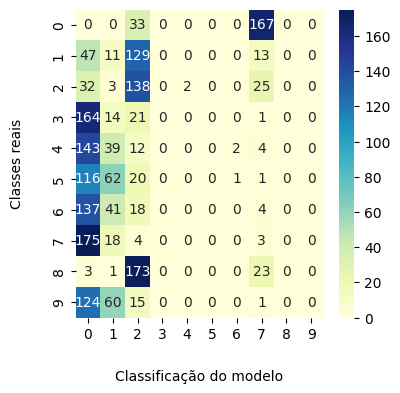

***********************
Épocas:  10
Função de custo:  1501.5129091571662
----------------
Parâmetros de Largura s:  [[0.01313658 0.01324445 0.01320244 0.01322763 0.01324662 0.01318562
  0.01319866 0.01317208 0.01318262 0.01312842 0.01312813 0.01319093
  0.01313738 0.01320235 0.01316116 0.0131709  0.01314405 0.01311121
  0.01316874 0.01314668 0.01316462 0.01316959 0.01312318 0.01313903
  0.01316356 0.01316103 0.01314021 0.01313542 0.01314644 0.01316946
  0.01316057 0.01315564 0.01312897 0.01314823 0.01316812 0.0131636
  0.01314454 0.01314518 0.01314405 0.01317548 0.01316647 0.01314979
  0.01314027 0.0131372  0.01315793 0.01314621 0.01313809 0.01314095
  0.01316418 0.01313487 0.01313271 0.01313351 0.01315887 0.01313712
  0.01312889 0.01315007 0.01315514 0.01312415 0.01313924 0.01312811
  0.01313887 0.01315746 0.01312706 0.01317791 0.01315613 0.01312951
  0.01313924 0.01315598 0.01310492 0.01317747 0.01315242 0.01323185
  0.01318666 0.01319118 0.01317621 0.01319978]
 [0.01313658 0.0132444

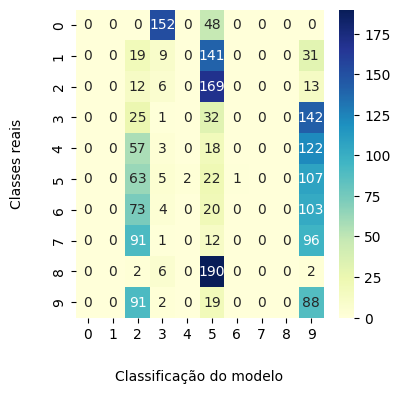

***********************
Épocas:  11
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01313468 0.01326197 0.01321138 0.01324049 0.01326462 0.01318739
  0.01320313 0.01317294 0.01318613 0.0131213  0.0131158  0.01319741
  0.01312806 0.01321307 0.01316487 0.01317049 0.01313969 0.01310093
  0.01316631 0.01314381 0.01316463 0.01317273 0.0131135  0.01313886
  0.01316648 0.01316008 0.01313601 0.01312897 0.01314274 0.01317174
  0.01316216 0.01315271 0.01311907 0.01314511 0.01317159 0.01316463
  0.0131415  0.01314049 0.01313949 0.01318025 0.01316932 0.01314832
  0.013134   0.0131314  0.01315927 0.01314383 0.01313518 0.01314052
  0.01316573 0.013132   0.01312844 0.01313074 0.01315899 0.01313563
  0.01312437 0.01315174 0.01315487 0.01312129 0.0131381  0.01312601
  0.01313609 0.01316054 0.01312201 0.01318815 0.01315387 0.01313023
  0.0131384  0.01315729 0.0130927  0.01318641 0.01315223 0.0132465
  0.01319173 0.01319392 0.01318081 0.01320216]
 [0.01313468 0.0132619

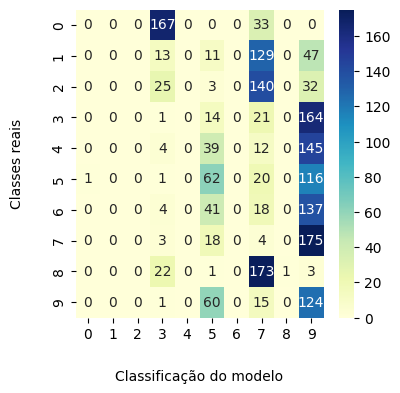

***********************
Épocas:  12
Função de custo:  1513.1483911777905
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01314798 0.013075

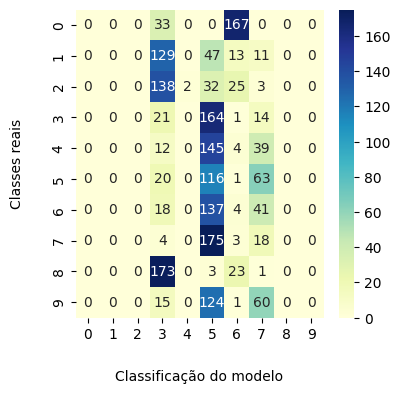

***********************
Épocas:  13
Função de custo:  1513.1483911777905
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01314798 0.013075

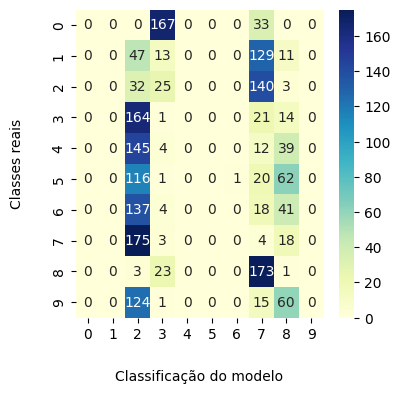

***********************
Épocas:  14
Função de custo:  1507.3007936068943
----------------
Parâmetros de Largura s:  [[0.01313559 0.01325364 0.01320728 0.01323448 0.01325598 0.01318676
  0.01320116 0.01317294 0.01318454 0.01312461 0.01312196 0.01319424
  0.01313278 0.01320788 0.01316292 0.01317088 0.01314141 0.01310571
  0.01316774 0.01314518 0.01316462 0.01317114 0.01311798 0.01313848
  0.01316496 0.01316045 0.01313788 0.01313181 0.01314447 0.0131707
  0.0131613  0.01315406 0.01312371 0.01314641 0.01316992 0.0131641
  0.01314281 0.01314255 0.01314157 0.01317797 0.01316788 0.01314888
  0.01313687 0.01313397 0.01315862 0.01314508 0.01313651 0.01314057
  0.01316505 0.01313331 0.01313045 0.01313212 0.01315899 0.01313627
  0.0131266  0.0131509  0.01315503 0.01312254 0.01313859 0.01312703
  0.01313742 0.01315897 0.01312453 0.01318305 0.01315514 0.01312954
  0.01313886 0.01315694 0.01309839 0.01318215 0.01315279 0.01323961
  0.0131897  0.01319293 0.01317879 0.01320131]
 [0.01313559 0.01325365

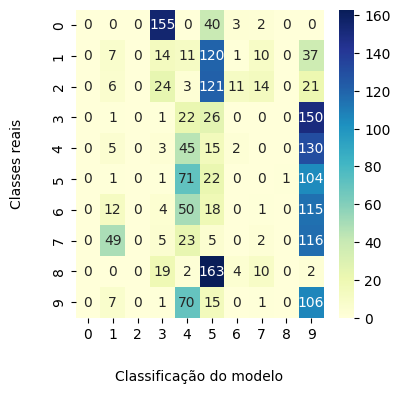

***********************
Épocas:  15
Função de custo:  1501.512909157166
----------------
Parâmetros de Largura s:  [[0.01313658 0.01324445 0.01320244 0.01322763 0.01324662 0.01318562
  0.01319866 0.01317208 0.01318262 0.01312842 0.01312813 0.01319093
  0.01313738 0.01320235 0.01316116 0.0131709  0.01314405 0.01311121
  0.01316874 0.01314668 0.01316462 0.01316959 0.01312318 0.01313903
  0.01316356 0.01316103 0.01314021 0.01313542 0.01314644 0.01316946
  0.01316057 0.01315564 0.01312897 0.01314823 0.01316812 0.0131636
  0.01314454 0.01314518 0.01314405 0.01317548 0.01316647 0.01314979
  0.01314027 0.0131372  0.01315793 0.01314621 0.01313809 0.01314095
  0.01316418 0.01313487 0.01313271 0.01313351 0.01315887 0.01313712
  0.01312889 0.01315007 0.01315514 0.01312415 0.01313924 0.01312811
  0.01313887 0.01315746 0.01312706 0.01317791 0.01315613 0.01312951
  0.01313924 0.01315598 0.01310492 0.01317747 0.01315242 0.01323185
  0.01318666 0.01319118 0.01317621 0.01319978]
 [0.01314762 0.01307199

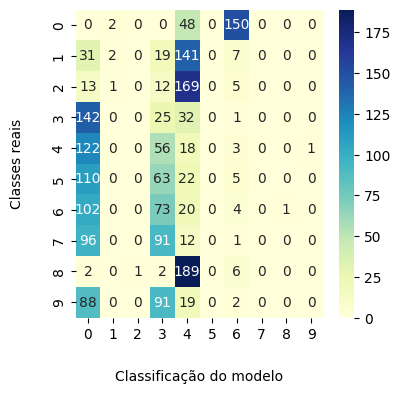

***********************
Épocas:  16
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01313468 0.013261

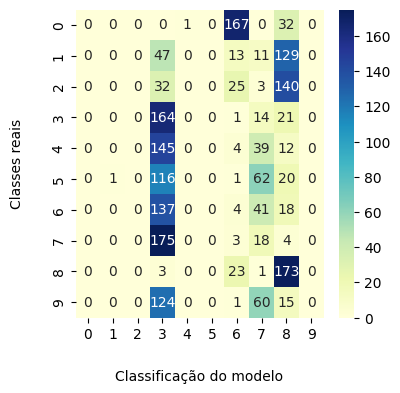

***********************
Épocas:  17
Função de custo:  1501.5129091571662
----------------
Parâmetros de Largura s:  [[0.01313658 0.01324445 0.01320244 0.01322763 0.01324662 0.01318562
  0.01319866 0.01317208 0.01318262 0.01312842 0.01312813 0.01319093
  0.01313738 0.01320235 0.01316116 0.0131709  0.01314405 0.01311121
  0.01316874 0.01314668 0.01316462 0.01316959 0.01312318 0.01313903
  0.01316356 0.01316103 0.01314021 0.01313542 0.01314644 0.01316946
  0.01316057 0.01315564 0.01312897 0.01314823 0.01316812 0.0131636
  0.01314454 0.01314518 0.01314405 0.01317548 0.01316647 0.01314979
  0.01314027 0.0131372  0.01315793 0.01314621 0.01313809 0.01314095
  0.01316418 0.01313487 0.01313271 0.01313351 0.01315887 0.01313712
  0.01312889 0.01315007 0.01315514 0.01312415 0.01313924 0.01312811
  0.01313887 0.01315746 0.01312706 0.01317791 0.01315613 0.01312951
  0.01313924 0.01315598 0.01310492 0.01317747 0.01315242 0.01323185
  0.01318666 0.01319118 0.01317621 0.01319978]
 [0.01314762 0.0130719

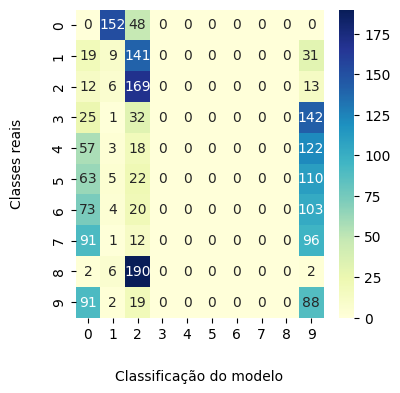

***********************
Épocas:  18
Função de custo:  1507.3009619564032
----------------
Parâmetros de Largura s:  [[0.01314775 0.01307319 0.01308816 0.01310387 0.01307934 0.01314726
  0.01313208 0.01310351 0.01316622 0.01318695 0.01314221 0.01315567
  0.01312961 0.01314834 0.01316498 0.01315831 0.01318483 0.0131644
  0.01316673 0.01318196 0.01316347 0.01316453 0.01317728 0.01318196
  0.01317548 0.01316491 0.01318224 0.01317292 0.01317504 0.01316972
  0.01317113 0.01317132 0.01317596 0.01317464 0.0131695  0.01317048
  0.01317296 0.01317318 0.01317468 0.01316616 0.01317046 0.01317697
  0.01317263 0.0131773  0.01316609 0.01317256 0.01317332 0.01317478
  0.01316877 0.01317477 0.01317271 0.01317427 0.01316211 0.01317799
  0.0131706  0.01317431 0.01316519 0.01318371 0.01316527 0.01317986
  0.01315457 0.0131675  0.01316284 0.01316615 0.01315413 0.01318983
  0.01316092 0.01316225 0.01315348 0.01314595 0.01315215 0.01308228
  0.01309783 0.01311179 0.01316835 0.01304341]
 [0.01314774 0.0130731

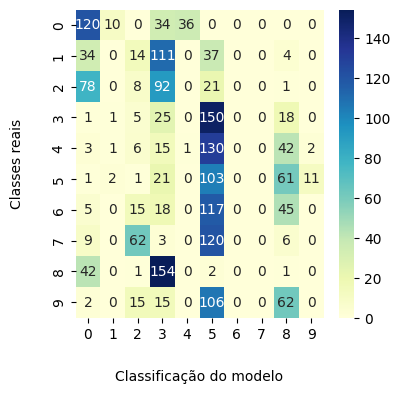

***********************
Épocas:  19
Função de custo:  1501.5129091571662
----------------
Parâmetros de Largura s:  [[0.01314762 0.01307199 0.01308609 0.01310076 0.0130758  0.01314599
  0.01312932 0.01310107 0.01316489 0.01318852 0.01314171 0.0131547
  0.01312782 0.0131475  0.01316538 0.01315812 0.01318483 0.01316555
  0.01316538 0.01318274 0.01316334 0.01316467 0.01317822 0.01318311
  0.01317611 0.01316479 0.01318261 0.01317297 0.01317531 0.0131698
  0.01317172 0.01317088 0.01317608 0.0131746  0.01316993 0.01317066
  0.0131733  0.0131733  0.01317488 0.0131664  0.01317072 0.01317744
  0.01317261 0.01317768 0.01316669 0.01317332 0.01317429 0.01317598
  0.01316918 0.01317593 0.01317351 0.01317525 0.01316225 0.01317954
  0.01317166 0.01317522 0.01316594 0.01318524 0.01316603 0.01318138
  0.01315476 0.01316839 0.01316375 0.01316754 0.01315461 0.01319169
  0.01316185 0.01316276 0.01315421 0.01314629 0.01315288 0.01308021
  0.01309709 0.01310965 0.01316868 0.0130373 ]
 [0.01313658 0.01324445

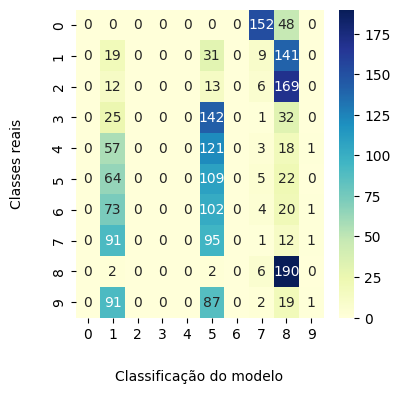

***********************
Épocas:  20
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01313468 0.013261

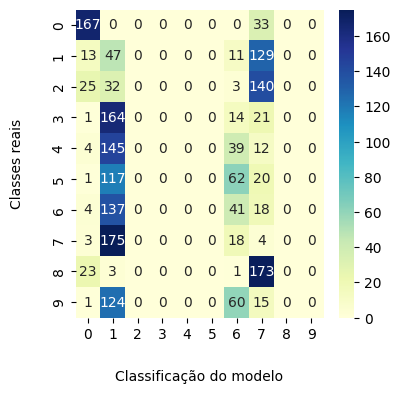

***********************
Épocas:  21
Função de custo:  1507.3007514308338
----------------
Parâmetros de Largura s:  [[0.01313558 0.01325368 0.01320729 0.01323454 0.01325596 0.01318677
  0.01320119 0.01317293 0.01318456 0.01312462 0.01312195 0.01319423
  0.01313278 0.01320788 0.01316291 0.01317088 0.01314141 0.0131057
  0.01316773 0.01314519 0.01316462 0.01317113 0.01311797 0.01313846
  0.01316497 0.01316046 0.01313788 0.0131318  0.01314446 0.01317072
  0.01316132 0.01315406 0.0131237  0.0131464  0.01316995 0.01316412
  0.01314281 0.01314254 0.01314156 0.013178   0.0131679  0.01314888
  0.01313687 0.01313397 0.01315864 0.01314508 0.01313651 0.01314056
  0.01316507 0.01313331 0.01313044 0.0131321  0.01315901 0.01313626
  0.01312659 0.01315089 0.01315504 0.01312253 0.01313857 0.01312701
  0.01313742 0.01315896 0.01312452 0.01318304 0.01315514 0.01312953
  0.01313885 0.01315693 0.01309837 0.01318214 0.01315277 0.0132396
  0.01318968 0.01319296 0.0131788  0.01320134]
 [0.01313559 0.01325364

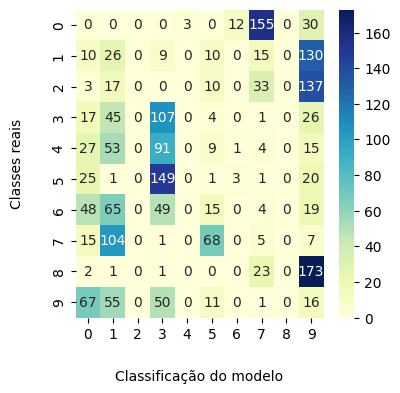

***********************
Épocas:  22
Função de custo:  1507.3009715352478
----------------
Parâmetros de Largura s:  [[0.01313558 0.0132537  0.01320729 0.01323457 0.01325596 0.01318677
  0.0132012  0.01317293 0.01318457 0.01312462 0.01312195 0.01319423
  0.01313277 0.01320787 0.01316291 0.01317088 0.0131414  0.01310569
  0.01316773 0.01314519 0.01316462 0.01317113 0.01311797 0.01313846
  0.01316498 0.01316047 0.01313788 0.0131318  0.01314445 0.01317073
  0.01316132 0.01315405 0.0131237  0.01314639 0.01316996 0.01316413
  0.01314281 0.01314254 0.01314156 0.01317801 0.01316791 0.01314888
  0.01313687 0.01313396 0.01315865 0.01314508 0.01313651 0.01314055
  0.01316508 0.01313331 0.01313043 0.0131321  0.01315901 0.01313626
  0.01312659 0.01315088 0.01315504 0.01312253 0.01313857 0.01312701
  0.01313742 0.01315895 0.01312451 0.01318304 0.01315514 0.01312953
  0.01313885 0.01315693 0.01309837 0.01318214 0.01315277 0.01323959
  0.01318968 0.01319296 0.01317881 0.01320135]
 [0.01314774 0.013073

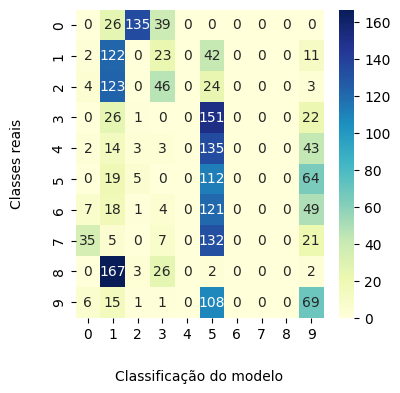

***********************
Épocas:  23
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01313468 0.013261

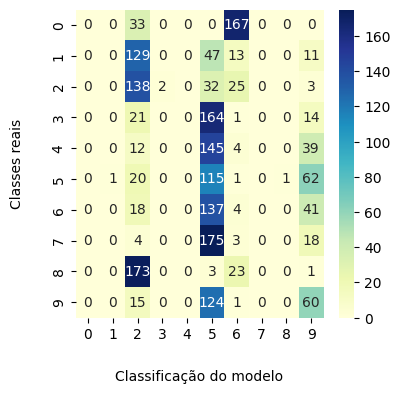

***********************
Épocas:  24
Função de custo:  1507.3007326584377
----------------
Parâmetros de Largura s:  [[0.01314774 0.0130732  0.01308815 0.01310389 0.01307934 0.01314726
  0.01313208 0.0131035  0.01316622 0.01318694 0.01314221 0.01315565
  0.01312961 0.0131483  0.01316499 0.01315831 0.01318481 0.01316439
  0.01316672 0.01318195 0.01316346 0.01316452 0.01317727 0.01318195
  0.01317548 0.0131649  0.01318223 0.01317291 0.01317503 0.01316972
  0.01317113 0.01317132 0.01317595 0.01317462 0.0131695  0.01317048
  0.01317296 0.01317317 0.01317467 0.01316616 0.01317046 0.01317697
  0.01317262 0.01317729 0.01316609 0.01317257 0.01317332 0.01317478
  0.01316877 0.01317477 0.01317271 0.01317427 0.01316211 0.01317799
  0.0131706  0.01317431 0.01316519 0.01318371 0.01316527 0.01317986
  0.01315457 0.0131675  0.01316285 0.01316615 0.01315413 0.01318983
  0.01316093 0.01316226 0.0131535  0.01314597 0.01315218 0.0130823
  0.01309784 0.01311182 0.01316836 0.01304344]
 [0.01314775 0.0130731

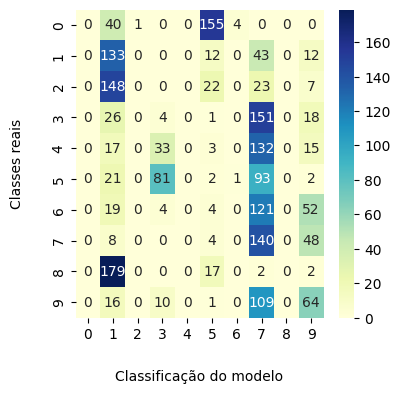

***********************
Épocas:  25
Função de custo:  1507.300660078479
----------------
Parâmetros de Largura s:  [[0.01313558 0.01325367 0.01320728 0.01323453 0.01325597 0.01318677
  0.01320118 0.01317293 0.01318456 0.01312462 0.01312195 0.01319423
  0.01313278 0.01320788 0.01316291 0.01317088 0.01314141 0.0131057
  0.01316774 0.01314519 0.01316462 0.01317114 0.01311798 0.01313847
  0.01316497 0.01316046 0.01313788 0.01313181 0.01314446 0.01317072
  0.01316131 0.01315406 0.01312371 0.0131464  0.01316995 0.01316412
  0.01314281 0.01314255 0.01314156 0.013178   0.0131679  0.01314888
  0.01313687 0.01313397 0.01315864 0.01314508 0.01313651 0.01314056
  0.01316507 0.01313331 0.01313044 0.0131321  0.013159   0.01313626
  0.01312659 0.01315089 0.01315503 0.01312253 0.01313857 0.01312701
  0.01313742 0.01315896 0.01312451 0.01318304 0.01315514 0.01312953
  0.01313885 0.01315693 0.01309838 0.01318214 0.01315277 0.0132396
  0.01318968 0.01319295 0.0131788  0.01320133]
 [0.0131356  0.01325362 

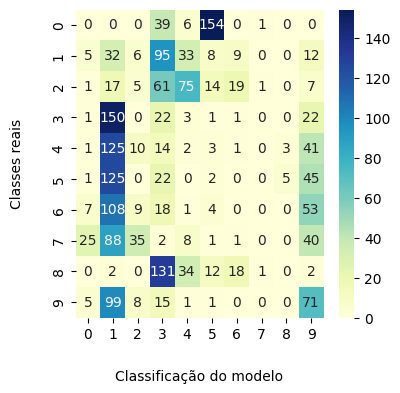

***********************
Épocas:  26
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01313468 0.01326197 0.01321138 0.01324049 0.01326462 0.01318739
  0.01320313 0.01317294 0.01318613 0.0131213  0.0131158  0.01319741
  0.01312806 0.01321307 0.01316487 0.01317049 0.01313969 0.01310093
  0.01316631 0.01314381 0.01316463 0.01317273 0.0131135  0.01313886
  0.01316648 0.01316008 0.01313601 0.01312897 0.01314274 0.01317174
  0.01316216 0.01315271 0.01311907 0.01314511 0.01317159 0.01316463
  0.0131415  0.01314049 0.01313949 0.01318025 0.01316932 0.01314832
  0.013134   0.0131314  0.01315927 0.01314383 0.01313518 0.01314052
  0.01316573 0.013132   0.01312844 0.01313074 0.01315899 0.01313563
  0.01312437 0.01315174 0.01315487 0.01312129 0.0131381  0.01312601
  0.01313609 0.01316054 0.01312201 0.01318815 0.01315387 0.01313023
  0.0131384  0.01315729 0.0130927  0.01318641 0.01315223 0.0132465
  0.01319173 0.01319392 0.01318081 0.01320216]
 [0.01314798 0.0130751

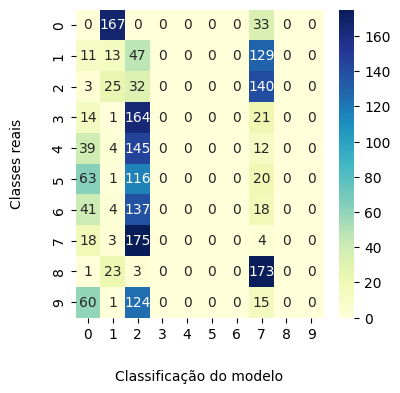

***********************
Épocas:  27
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01313468 0.01326197 0.01321138 0.01324049 0.01326462 0.01318739
  0.01320313 0.01317294 0.01318613 0.0131213  0.0131158  0.01319741
  0.01312806 0.01321307 0.01316487 0.01317049 0.01313969 0.01310093
  0.01316631 0.01314381 0.01316463 0.01317273 0.0131135  0.01313886
  0.01316648 0.01316008 0.01313601 0.01312897 0.01314274 0.01317174
  0.01316216 0.01315271 0.01311907 0.01314511 0.01317159 0.01316463
  0.0131415  0.01314049 0.01313949 0.01318025 0.01316932 0.01314832
  0.013134   0.0131314  0.01315927 0.01314383 0.01313518 0.01314052
  0.01316573 0.013132   0.01312844 0.01313074 0.01315899 0.01313563
  0.01312437 0.01315174 0.01315487 0.01312129 0.0131381  0.01312601
  0.01313609 0.01316054 0.01312201 0.01318815 0.01315387 0.01313023
  0.0131384  0.01315729 0.0130927  0.01318641 0.01315223 0.0132465
  0.01319173 0.01319392 0.01318081 0.01320216]
 [0.01314798 0.0130751

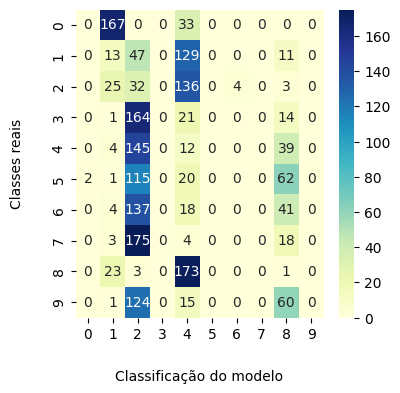

***********************
Épocas:  28
Função de custo:  1518.7725751614666
----------------
Parâmetros de Largura s:  [[0.0131338  0.01327004 0.01321487 0.01324601 0.01327316 0.0131875
  0.0132046  0.01317189 0.01318748 0.01311851 0.01310927 0.01320058
  0.01312297 0.01321827 0.01316718 0.01316965 0.01313915 0.01309655
  0.01316434 0.01314245 0.01316465 0.01317449 0.0131096  0.01314038
  0.01316825 0.01315996 0.01313469 0.01312691 0.01314102 0.01317261
  0.0131632  0.01315156 0.01311495 0.01314443 0.0131732  0.0131652
  0.01314068 0.01313909 0.0131377  0.01318239 0.01317086 0.01314814
  0.0131316  0.01312949 0.01315986 0.01314229 0.01313401 0.01314083
  0.01316623 0.01313085 0.01312657 0.01312912 0.01315884 0.01313506
  0.01312191 0.01315266 0.01315452 0.01312036 0.01313764 0.01312487
  0.01313463 0.01316229 0.01311919 0.0131936  0.01315211 0.01313169
  0.01313773 0.01315689 0.01308755 0.01319054 0.01315046 0.01325297
  0.01319266 0.01319404 0.01318237 0.01320234]
 [0.01314849 0.01307817

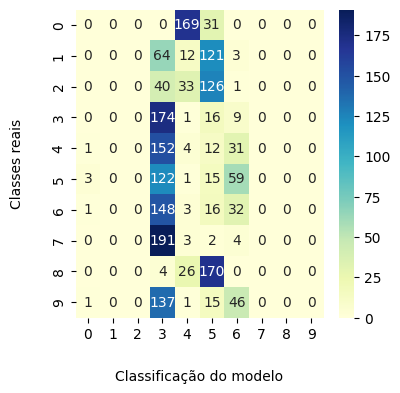

***********************
Épocas:  29
Função de custo:  1507.3038796317578
----------------
Parâmetros de Largura s:  [[0.01313563 0.01325358 0.01320729 0.01323432 0.013256   0.01318673
  0.0132011  0.01317298 0.01318448 0.01312457 0.01312198 0.01319426
  0.01313279 0.01320787 0.01316294 0.01317086 0.01314138 0.01310573
  0.01316772 0.01314515 0.01316461 0.01317114 0.01311796 0.01313848
  0.01316494 0.01316041 0.01313786 0.01313182 0.01314448 0.01317064
  0.01316126 0.01315406 0.0131237  0.01314641 0.01316986 0.01316405
  0.01314279 0.01314254 0.01314158 0.01317791 0.01316782 0.01314886
  0.01313686 0.01313397 0.01315858 0.01314508 0.01313654 0.01314062
  0.01316501 0.01313333 0.01313049 0.01313218 0.01315895 0.01313629
  0.01312665 0.01315095 0.01315502 0.01312257 0.01313866 0.01312709
  0.01313744 0.013159   0.01312462 0.01318308 0.01315514 0.01312956
  0.01313893 0.013157   0.01309841 0.0131822  0.01315291 0.01323965
  0.0131898  0.01319289 0.01317876 0.01320124]
 [0.01313558 0.013253

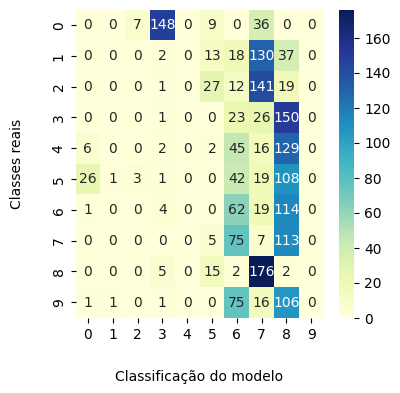

***********************
Épocas:  30
Função de custo:  1507.3010830325425
----------------
Parâmetros de Largura s:  [[0.01314774 0.0130732  0.01308815 0.01310389 0.01307934 0.01314727
  0.01313208 0.0131035  0.01316622 0.01318694 0.01314221 0.01315565
  0.01312961 0.0131483  0.01316499 0.01315831 0.01318481 0.01316439
  0.01316672 0.01318195 0.01316346 0.01316452 0.01317727 0.01318195
  0.01317548 0.0131649  0.01318223 0.01317291 0.01317503 0.01316972
  0.01317113 0.01317132 0.01317595 0.01317462 0.0131695  0.01317048
  0.01317296 0.01317317 0.01317467 0.01316616 0.01317046 0.01317697
  0.01317262 0.01317729 0.01316609 0.01317257 0.01317332 0.01317478
  0.01316877 0.01317477 0.01317271 0.01317427 0.01316211 0.01317799
  0.0131706  0.01317431 0.01316519 0.01318371 0.01316527 0.01317986
  0.01315457 0.0131675  0.01316285 0.01316615 0.01315413 0.01318983
  0.01316093 0.01316226 0.0131535  0.01314597 0.01315218 0.0130823
  0.01309784 0.01311182 0.01316837 0.01304344]
 [0.01314774 0.0130731

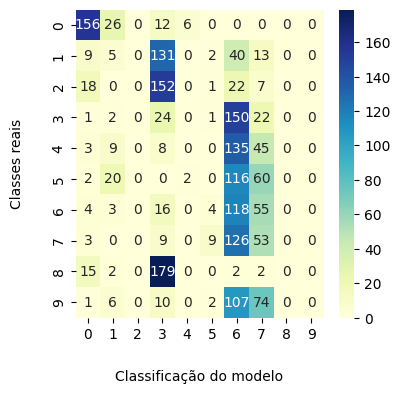

***********************
Épocas:  31
Função de custo:  1513.14839117779
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01314798 0.01307511

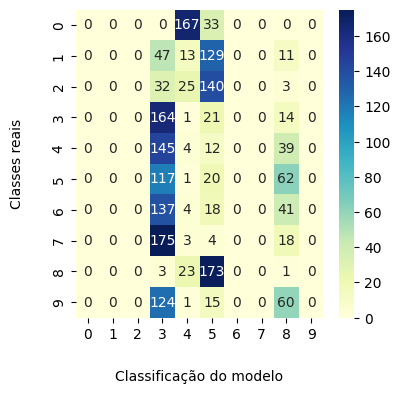

***********************
Épocas:  32
Função de custo:  1507.3009666601517
----------------
Parâmetros de Largura s:  [[0.01313557 0.01325371 0.01320729 0.0132346  0.01325595 0.01318678
  0.01320121 0.01317293 0.01318458 0.01312462 0.01312194 0.01319422
  0.01313277 0.01320787 0.0131629  0.01317088 0.01314141 0.01310568
  0.01316773 0.01314519 0.01316462 0.01317113 0.01311797 0.01313845
  0.01316498 0.01316047 0.01313788 0.01313179 0.01314445 0.01317074
  0.01316133 0.01315405 0.0131237  0.01314639 0.01316997 0.01316414
  0.01314281 0.01314254 0.01314155 0.01317802 0.01316792 0.01314889
  0.01313687 0.01313396 0.01315866 0.01314509 0.0131365  0.01314055
  0.01316508 0.01313331 0.01313043 0.01313209 0.01315902 0.01313626
  0.01312658 0.01315088 0.01315504 0.01312253 0.01313856 0.013127
  0.01313742 0.01315895 0.0131245  0.01318304 0.01315514 0.01312953
  0.01313884 0.01315693 0.01309836 0.01318213 0.01315275 0.01323959
  0.01318967 0.01319297 0.01317882 0.01320136]
 [0.01313559 0.01325364

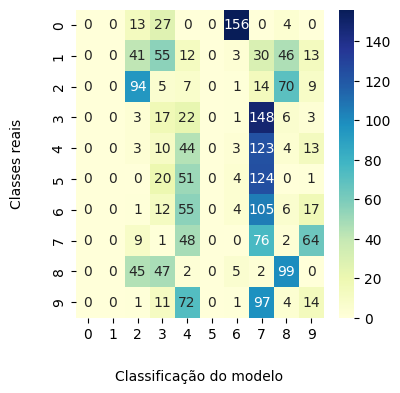

***********************
Épocas:  33
Função de custo:  1513.14839117779
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01314798 0.01307511

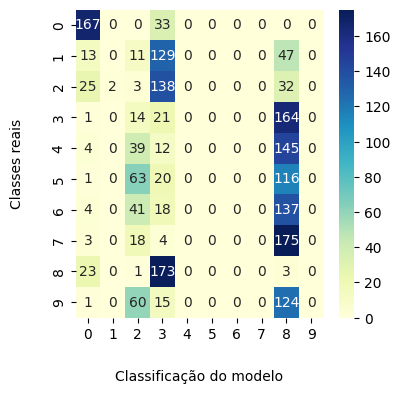

***********************
Épocas:  34
Função de custo:  1507.3012294939365
----------------
Parâmetros de Largura s:  [[0.01313564 0.01325349 0.01320724 0.0132342  0.01325604 0.01318674
  0.01320105 0.01317296 0.01318445 0.01312458 0.01312201 0.01319429
  0.01313281 0.0132079  0.01316296 0.01317087 0.01314141 0.01310577
  0.01316775 0.01314514 0.01316461 0.01317117 0.01311799 0.01313852
  0.01316492 0.0131604  0.01313787 0.01313186 0.01314453 0.01317061
  0.01316125 0.01315408 0.01312373 0.01314643 0.01316982 0.01316403
  0.01314279 0.01314257 0.01314161 0.01317787 0.01316779 0.01314886
  0.01313688 0.013134   0.01315854 0.01314507 0.01313655 0.01314063
  0.01316498 0.01313332 0.0131305  0.01313219 0.01315893 0.01313629
  0.01312666 0.01315095 0.01315501 0.01312257 0.01313866 0.01312711
  0.01313744 0.01315901 0.01312462 0.01318309 0.01315514 0.01312955
  0.01313892 0.01315699 0.01309845 0.0131822  0.01315289 0.01323968
  0.01318979 0.01319284 0.01317872 0.0132012 ]
 [0.01313557 0.013253

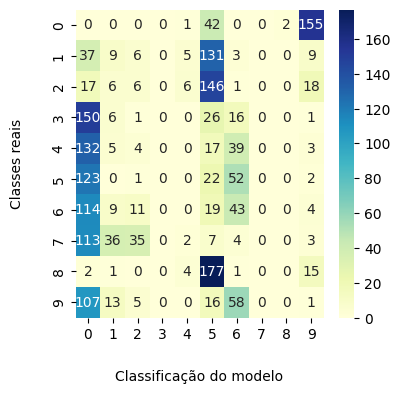

***********************
Épocas:  35
Função de custo:  1507.3010952663253
----------------
Parâmetros de Largura s:  [[0.01314774 0.0130732  0.01308814 0.01310388 0.01307933 0.01314726
  0.01313208 0.01310349 0.01316621 0.01318694 0.01314221 0.01315565
  0.01312961 0.01314829 0.01316499 0.0131583  0.0131848  0.0131644
  0.01316672 0.01318195 0.01316346 0.01316452 0.01317727 0.01318195
  0.01317548 0.0131649  0.01318223 0.01317291 0.01317503 0.01316972
  0.01317113 0.01317131 0.01317595 0.01317462 0.01316949 0.01317047
  0.01317296 0.01317317 0.01317467 0.01316616 0.01317046 0.01317697
  0.01317262 0.01317729 0.01316609 0.01317257 0.01317332 0.01317478
  0.01316877 0.01317477 0.01317271 0.01317428 0.01316211 0.01317799
  0.0131706  0.01317432 0.01316519 0.01318372 0.01316528 0.01317987
  0.01315457 0.01316751 0.01316285 0.01316616 0.01315413 0.01318983
  0.01316094 0.01316227 0.01315351 0.01314597 0.01315219 0.01308231
  0.01309784 0.01311183 0.01316836 0.01304345]
 [0.01314775 0.0130731

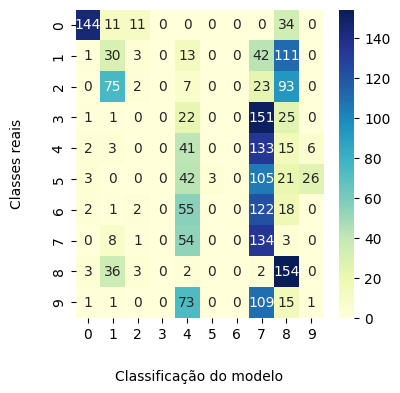

***********************
Épocas:  36
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01314798 0.013075

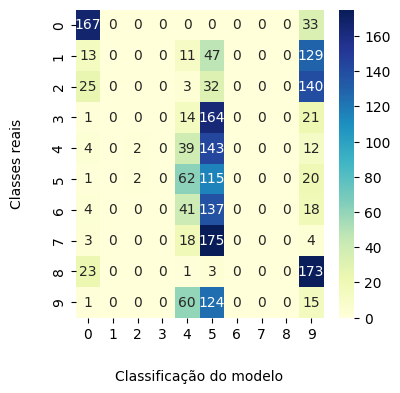

***********************
Épocas:  37
Função de custo:  1507.3007351794868
----------------
Parâmetros de Largura s:  [[0.0131356  0.01325363 0.01320728 0.01323445 0.01325598 0.01318676
  0.01320115 0.01317294 0.01318453 0.01312461 0.01312197 0.01319425
  0.01313279 0.01320788 0.01316292 0.01317087 0.01314141 0.01310572
  0.01316774 0.01314517 0.01316462 0.01317114 0.01311798 0.01313848
  0.01316496 0.01316045 0.01313788 0.01313182 0.01314448 0.01317069
  0.0131613  0.01315406 0.01312371 0.01314641 0.01316991 0.0131641
  0.0131428  0.01314255 0.01314158 0.01317796 0.01316787 0.01314888
  0.01313687 0.01313398 0.01315862 0.01314508 0.01313652 0.01314058
  0.01316505 0.01313331 0.01313045 0.01313213 0.01315898 0.01313627
  0.01312661 0.0131509  0.01315503 0.01312255 0.0131386  0.01312704
  0.01313743 0.01315897 0.01312454 0.01318306 0.01315514 0.01312954
  0.01313887 0.01315695 0.01309839 0.01318216 0.0131528  0.01323962
  0.01318971 0.01319293 0.01317878 0.0132013 ]
 [0.01314774 0.0130731

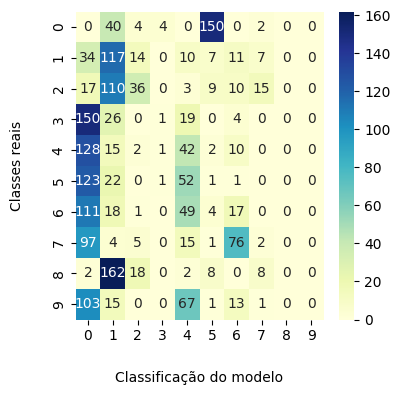

***********************
Épocas:  38
Função de custo:  1501.512909157166
----------------
Parâmetros de Largura s:  [[0.01314762 0.01307199 0.01308609 0.01310076 0.0130758  0.01314599
  0.01312932 0.01310107 0.01316489 0.01318852 0.01314171 0.0131547
  0.01312782 0.0131475  0.01316538 0.01315812 0.01318483 0.01316555
  0.01316538 0.01318274 0.01316334 0.01316467 0.01317822 0.01318311
  0.01317611 0.01316479 0.01318261 0.01317297 0.01317531 0.0131698
  0.01317172 0.01317088 0.01317608 0.0131746  0.01316993 0.01317066
  0.0131733  0.0131733  0.01317488 0.0131664  0.01317072 0.01317744
  0.01317261 0.01317768 0.01316669 0.01317332 0.01317429 0.01317598
  0.01316918 0.01317593 0.01317351 0.01317525 0.01316225 0.01317954
  0.01317166 0.01317522 0.01316594 0.01318524 0.01316603 0.01318138
  0.01315476 0.01316839 0.01316375 0.01316754 0.01315461 0.01319169
  0.01316185 0.01316276 0.01315421 0.01314629 0.01315288 0.01308021
  0.01309709 0.01310965 0.01316868 0.0130373 ]
 [0.01314762 0.01307199 

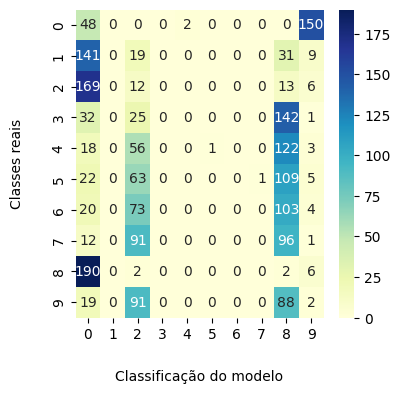

***********************
Épocas:  39
Função de custo:  1507.3010410258203
----------------
Parâmetros de Largura s:  [[0.01313554 0.01325379 0.01320731 0.01323474 0.01325592 0.01318679
  0.01320127 0.01317292 0.01318463 0.01312464 0.01312192 0.0131942
  0.01313275 0.01320786 0.01316288 0.01317088 0.0131414  0.01310565
  0.01316772 0.01314521 0.01316462 0.01317111 0.01311796 0.01313843
  0.01316501 0.0131605  0.01313788 0.01313177 0.01314441 0.01317079
  0.01316135 0.01315404 0.01312369 0.01314637 0.01317002 0.01316417
  0.01314282 0.01314253 0.01314153 0.01317808 0.01316797 0.0131489
  0.01313686 0.01313395 0.0131587  0.01314509 0.01313648 0.01314052
  0.01316512 0.01313331 0.0131304  0.01313205 0.01315905 0.01313625
  0.01312655 0.01315085 0.01315505 0.01312251 0.01313853 0.01312696
  0.01313741 0.01315892 0.01312446 0.01318302 0.01315514 0.01312952
  0.01313881 0.01315691 0.01309833 0.01318211 0.01315271 0.01323955
  0.01318962 0.01319302 0.01317885 0.01320141]
 [0.01313559 0.01325367

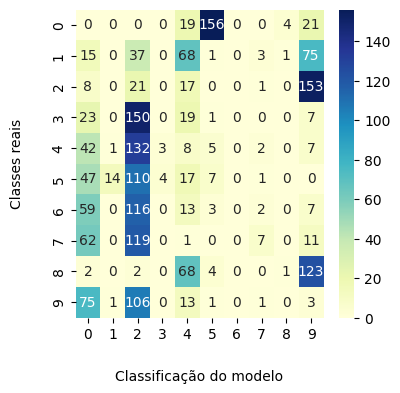

***********************
Épocas:  40
Função de custo:  1507.3029553489914
----------------
Parâmetros de Largura s:  [[0.01314774 0.01307319 0.01308814 0.01310386 0.01307932 0.01314725
  0.01313208 0.01310349 0.0131662  0.01318694 0.01314221 0.01315565
  0.01312961 0.0131483  0.01316498 0.0131583  0.01318481 0.0131644
  0.01316672 0.01318195 0.01316346 0.01316452 0.01317728 0.01318195
  0.01317547 0.0131649  0.01318223 0.01317291 0.01317503 0.01316971
  0.01317113 0.01317131 0.01317595 0.01317463 0.01316949 0.01317047
  0.01317296 0.01317317 0.01317467 0.01316615 0.01317046 0.01317697
  0.01317262 0.01317729 0.01316609 0.01317257 0.01317333 0.01317479
  0.01316877 0.01317478 0.01317271 0.01317428 0.01316211 0.01317799
  0.01317061 0.01317432 0.01316519 0.01318372 0.01316528 0.01317987
  0.01315457 0.01316751 0.01316285 0.01316616 0.01315413 0.01318984
  0.01316094 0.01316227 0.01315351 0.01314597 0.01315219 0.01308232
  0.01309784 0.01311183 0.01316836 0.01304344]
 [0.01313548 0.0132540

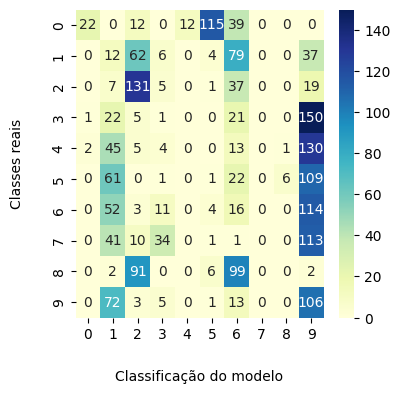

***********************
Épocas:  41
Função de custo:  1507.3008747246417
----------------
Parâmetros de Largura s:  [[0.01314774 0.01307317 0.01308814 0.01310382 0.0130793  0.01314723
  0.01313207 0.01310349 0.01316619 0.01318695 0.0131422  0.01315565
  0.0131296  0.01314832 0.01316498 0.0131583  0.01318482 0.01316441
  0.01316672 0.01318195 0.01316347 0.01316453 0.01317729 0.01318196
  0.01317547 0.0131649  0.01318224 0.01317291 0.01317504 0.0131697
  0.01317113 0.01317131 0.01317596 0.01317463 0.01316949 0.01317047
  0.01317296 0.01317318 0.01317468 0.01316615 0.01317045 0.01317697
  0.01317262 0.0131773  0.01316609 0.01317256 0.01317333 0.01317479
  0.01316877 0.01317478 0.01317272 0.01317428 0.01316211 0.013178
  0.01317061 0.01317433 0.01316519 0.01318373 0.01316528 0.01317988
  0.01315458 0.01316751 0.01316285 0.01316617 0.01315414 0.01318984
  0.01316094 0.01316227 0.01315351 0.01314596 0.01315218 0.01308233
  0.01309783 0.01311182 0.01316834 0.01304342]
 [0.01314774 0.01307321 

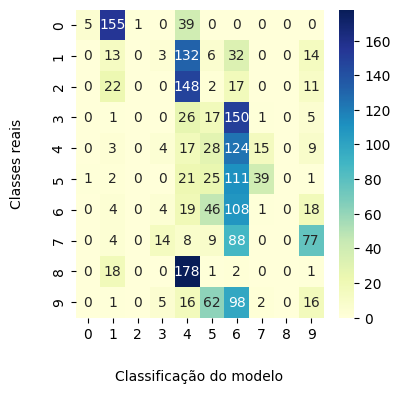

***********************
Épocas:  42
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01313468 0.01326197 0.01321138 0.01324049 0.01326462 0.01318739
  0.01320313 0.01317294 0.01318613 0.0131213  0.0131158  0.01319741
  0.01312806 0.01321307 0.01316487 0.01317049 0.01313969 0.01310093
  0.01316631 0.01314381 0.01316463 0.01317273 0.0131135  0.01313886
  0.01316648 0.01316008 0.01313601 0.01312897 0.01314274 0.01317174
  0.01316216 0.01315271 0.01311907 0.01314511 0.01317159 0.01316463
  0.0131415  0.01314049 0.01313949 0.01318025 0.01316932 0.01314832
  0.013134   0.0131314  0.01315927 0.01314383 0.01313518 0.01314052
  0.01316573 0.013132   0.01312844 0.01313074 0.01315899 0.01313563
  0.01312437 0.01315174 0.01315487 0.01312129 0.0131381  0.01312601
  0.01313609 0.01316054 0.01312201 0.01318815 0.01315387 0.01313023
  0.0131384  0.01315729 0.0130927  0.01318641 0.01315223 0.0132465
  0.01319173 0.01319392 0.01318081 0.01320216]
 [0.01313468 0.0132619

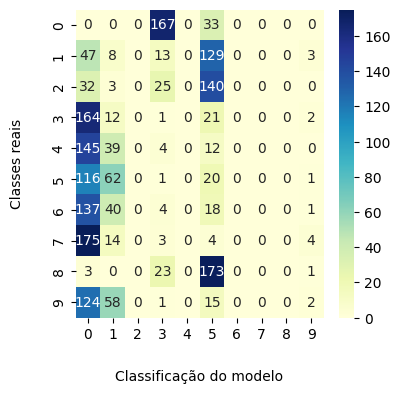

***********************
Épocas:  43
Função de custo:  1513.1483911777905
----------------
Parâmetros de Largura s:  [[0.01314798 0.01307511 0.01309065 0.01310759 0.01308354 0.01314837
  0.01313523 0.01310631 0.01316726 0.0131852  0.01314296 0.01315619
  0.01313168 0.01314901 0.01316442 0.01315821 0.01318421 0.01316334
  0.01316776 0.01318093 0.01316335 0.01316411 0.01317616 0.01318055
  0.01317451 0.01316468 0.0131815  0.01317251 0.01317446 0.01316943
  0.01317031 0.01317132 0.0131755  0.01317431 0.0131689  0.01317001
  0.01317234 0.01317264 0.01317409 0.0131658  0.01316994 0.01317615
  0.01317224 0.01317653 0.01316541 0.01317169 0.01317227 0.01317346
  0.01316822 0.01317354 0.01317182 0.01317323 0.01316192 0.01317634
  0.01316954 0.01317343 0.01316436 0.01318215 0.01316452 0.01317843
  0.01315439 0.01316653 0.0131621  0.0131649  0.0131537  0.01318792
  0.01316018 0.01316197 0.01315321 0.0131459  0.01315188 0.01308581
  0.0130993  0.01311511 0.0131681  0.01305136]
 [0.01313468 0.013261

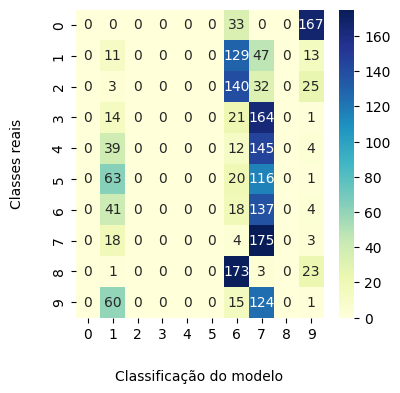

***********************
Épocas:  44
Função de custo:  1501.512909157166
----------------
Parâmetros de Largura s:  [[0.01313658 0.01324445 0.01320244 0.01322763 0.01324662 0.01318562
  0.01319866 0.01317208 0.01318262 0.01312842 0.01312813 0.01319093
  0.01313738 0.01320235 0.01316116 0.0131709  0.01314405 0.01311121
  0.01316874 0.01314668 0.01316462 0.01316959 0.01312318 0.01313903
  0.01316356 0.01316103 0.01314021 0.01313542 0.01314644 0.01316946
  0.01316057 0.01315564 0.01312897 0.01314823 0.01316812 0.0131636
  0.01314454 0.01314518 0.01314405 0.01317548 0.01316647 0.01314979
  0.01314027 0.0131372  0.01315793 0.01314621 0.01313809 0.01314095
  0.01316418 0.01313487 0.01313271 0.01313351 0.01315887 0.01313712
  0.01312889 0.01315007 0.01315514 0.01312415 0.01313924 0.01312811
  0.01313887 0.01315746 0.01312706 0.01317791 0.01315613 0.01312951
  0.01313924 0.01315598 0.01310492 0.01317747 0.01315242 0.01323185
  0.01318666 0.01319118 0.01317621 0.01319978]
 [0.01314762 0.01307199

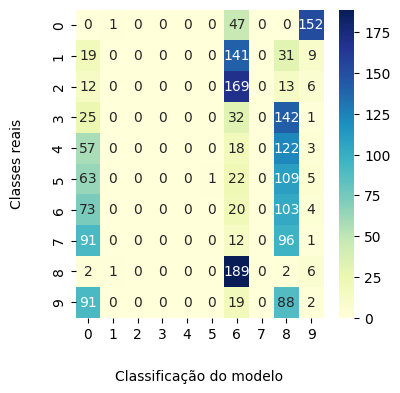

***********************
Épocas:  45
Função de custo:  1513.14839117779
----------------
Parâmetros de Largura s:  [[0.01313468 0.01326197 0.01321138 0.01324049 0.01326462 0.01318739
  0.01320313 0.01317294 0.01318613 0.0131213  0.0131158  0.01319741
  0.01312806 0.01321307 0.01316487 0.01317049 0.01313969 0.01310093
  0.01316631 0.01314381 0.01316463 0.01317273 0.0131135  0.01313886
  0.01316648 0.01316008 0.01313601 0.01312897 0.01314274 0.01317174
  0.01316216 0.01315271 0.01311907 0.01314511 0.01317159 0.01316463
  0.0131415  0.01314049 0.01313949 0.01318025 0.01316932 0.01314832
  0.013134   0.0131314  0.01315927 0.01314383 0.01313518 0.01314052
  0.01316573 0.013132   0.01312844 0.01313074 0.01315899 0.01313563
  0.01312437 0.01315174 0.01315487 0.01312129 0.0131381  0.01312601
  0.01313609 0.01316054 0.01312201 0.01318815 0.01315387 0.01313023
  0.0131384  0.01315729 0.0130927  0.01318641 0.01315223 0.0132465
  0.01319173 0.01319392 0.01318081 0.01320216]
 [0.01314798 0.01307511 

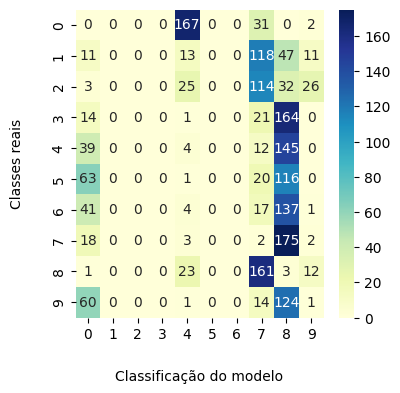

***********************
Épocas:  46
Função de custo:  1518.7725751613384
----------------
Parâmetros de Largura s:  [[0.01314849 0.01307817 0.01309411 0.01311247 0.01308915 0.01314953
  0.0131392  0.01311003 0.01316807 0.01318304 0.01314414 0.01315638
  0.01313431 0.01314975 0.01316352 0.01315789 0.01318285 0.01316229
  0.01316853 0.01317955 0.01316298 0.01316335 0.01317475 0.0131787
  0.01317307 0.0131641  0.01318024 0.01317173 0.01317351 0.0131689
  0.01316915 0.01317084 0.01317464 0.01317355 0.01316804 0.0131692
  0.0131713  0.01317161 0.01317302 0.01316527 0.01316911 0.01317483
  0.01317142 0.01317526 0.01316455 0.01317056 0.01317097 0.01317182
  0.01316741 0.01317204 0.01317069 0.01317195 0.01316162 0.01317435
  0.01316833 0.01317235 0.01316341 0.01318025 0.01316368 0.01317682
  0.01315422 0.01316529 0.01316142 0.01316357 0.01315336 0.01318565
  0.01315949 0.01316175 0.0131533  0.01314604 0.01315195 0.01309126
  0.0131019  0.01311993 0.0131678  0.0130622 ]
 [0.01314849 0.01307817 

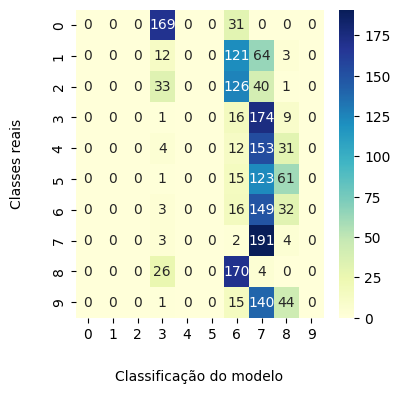

***********************
Épocas:  47
Função de custo:  1513.1483911777902
----------------
Parâmetros de Largura s:  [[0.01313468 0.01326197 0.01321138 0.01324049 0.01326462 0.01318739
  0.01320313 0.01317294 0.01318613 0.0131213  0.0131158  0.01319741
  0.01312806 0.01321307 0.01316487 0.01317049 0.01313969 0.01310093
  0.01316631 0.01314381 0.01316463 0.01317273 0.0131135  0.01313886
  0.01316648 0.01316008 0.01313601 0.01312897 0.01314274 0.01317174
  0.01316216 0.01315271 0.01311907 0.01314511 0.01317159 0.01316463
  0.0131415  0.01314049 0.01313949 0.01318025 0.01316932 0.01314832
  0.013134   0.0131314  0.01315927 0.01314383 0.01313518 0.01314052
  0.01316573 0.013132   0.01312844 0.01313074 0.01315899 0.01313563
  0.01312437 0.01315174 0.01315487 0.01312129 0.0131381  0.01312601
  0.01313609 0.01316054 0.01312201 0.01318815 0.01315387 0.01313023
  0.0131384  0.01315729 0.0130927  0.01318641 0.01315223 0.0132465
  0.01319173 0.01319392 0.01318081 0.01320216]
 [0.01314798 0.0130751

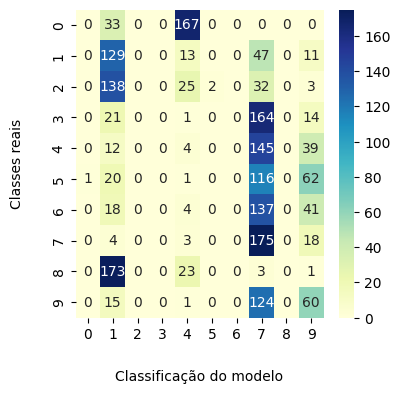

***********************
Épocas:  48
Função de custo:  1507.2997620281167
----------------
Parâmetros de Largura s:  [[0.01314769 0.01307297 0.01308792 0.0131032  0.01307887 0.01314685
  0.01313184 0.01310326 0.01316573 0.01318696 0.01314216 0.01315544
  0.01312952 0.01314803 0.01316497 0.01315813 0.01318475 0.01316451
  0.01316653 0.01318189 0.01316346 0.01316446 0.01317735 0.01318203
  0.01317536 0.01316475 0.01318223 0.01317283 0.01317499 0.01316949
  0.01317114 0.01317123 0.01317591 0.01317462 0.01316939 0.01317036
  0.01317293 0.01317313 0.01317469 0.013166   0.01317036 0.01317692
  0.01317255 0.01317726 0.01316607 0.01317261 0.01317349 0.01317496
  0.01316873 0.01317491 0.01317284 0.01317446 0.0131621  0.0131781
  0.0131708  0.01317454 0.01316521 0.013184   0.01316543 0.01318014
  0.01315469 0.01316764 0.01316302 0.01316643 0.01315418 0.01319004
  0.01316117 0.01316253 0.01315389 0.01314607 0.01315254 0.01308288
  0.01309788 0.01311221 0.01316829 0.01304347]
 [0.01313546 0.0132538

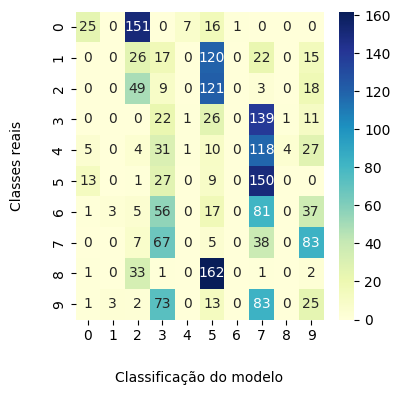

***********************
Épocas:  49
Função de custo:  1507.2992447725715
----------------
Parâmetros de Largura s:  [[0.01313555 0.01325367 0.01320723 0.01323459 0.01325598 0.01318681
  0.01320121 0.01317287 0.0131846  0.01312467 0.01312197 0.01319424
  0.0131328  0.01320792 0.01316292 0.0131709  0.01314147 0.01310572
  0.01316779 0.01314522 0.01316464 0.01317117 0.01311803 0.0131385
  0.01316499 0.01316051 0.01313792 0.01313184 0.0131445  0.01317075
  0.01316136 0.01315409 0.01312375 0.01314643 0.01316999 0.01316416
  0.01314284 0.01314259 0.0131416  0.01317803 0.01316794 0.0131489
  0.01313691 0.01313401 0.01315866 0.01314506 0.01313648 0.01314051
  0.01316509 0.01313328 0.01313039 0.01313204 0.01315902 0.01313624
  0.01312654 0.01315083 0.01315504 0.0131225  0.01313849 0.01312695
  0.01313741 0.01315893 0.0131244  0.01318302 0.01315514 0.0131295
  0.01313876 0.01315685 0.01309839 0.01318208 0.01315259 0.01323958
  0.01318956 0.01319296 0.01317878 0.01320137]
 [0.01314777 0.01307301 

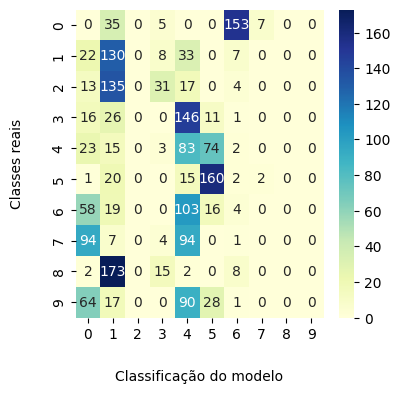

In [77]:
num_epocas = 1
algo = KFCM_K_W2(X)

best_custo = 100000
best_g = None
best_s = None

for num_epocas in range(50):
  print("***********************")
  print("Épocas: ", num_epocas)
  algo.fit()
  S = algo.compute_widths()
  g = algo.compute_prototypes()
  U = algo.update_membership()
  J_custo = algo.compute_JNew()
  if J_custo <= best_custo:
    best_custo = J_custo
    best_g = g
    best_s = S

  print("Função de custo: ", J_custo)
  print("----------------")
  print("Parâmetros de Largura s: ", S)
  print("----------------")
  print("Protótipos de cada grupo g:", g)
  print("----------------")
  print("Matriz U: ", U)

  #Partição Crisp
  x = np.array(range(0, 2000))
  pred_label=[]
  for i in range(2000):
    indice_max = np.argmax(U[:,i])
    pred_label.append(indice_max)

  label_1d = label.to_numpy().ravel()

  #ARI considerando a partição CRISP
  print("Predict labels:",pred_label)
  print("True labels:",np.transpose(label.to_numpy()))
  respred_label= np.reshape(pred_label, (2000,1)).ravel()
  ari=ARI(label.to_numpy().ravel(),respred_label)
  print("ARI:",ari)

  #Calcular partition coefficient
  cluster=10
  partition_coefficient = 0
  for i in range(cluster):
    for j in range(len(X)):
      partition_coefficient += U[i,j]**2
  partition_coefficient /= len(X)
  print("Fuzzy Partition Coefficient:", partition_coefficient)
  partition_coefficient = np.sum(U ** 2) / len(X)

  #Modified partition Coefficient
  MPC = 1 - ((cluster / (cluster - 1)) * (1 - partition_coefficient))

  print("Modified partition Coefficient:", MPC)

  true_labels = label.to_numpy().ravel()
  pred_labels = [int(i) for i in pred_label]
  conf_matrix = confusion_matrix(true_labels, pred_labels)

  #Plotar a matriz de confusão
  plt.figure(figsize=(4, 4))
  ax = sns.heatmap(
      conf_matrix,
      annot=True,
      fmt='d',
      cbar=True,
      cmap='YlGnBu'
  )
  ax.set_xlabel("Classificação do modelo", labelpad=20)
  ax.set_ylabel("Classes reais", labelpad=20)
  plt.show()

  #incrementa o número de épocas
  num_epocas += 1

In [82]:
    print("Parâmetros de Largura s: ")
    matriz_s = best_s
    pd.set_option('display.max_columns', 220)
    df_s = pd.DataFrame(matriz_s)
    df_s.style.highlight_max(axis=0, color='green')
    df_s

Parâmetros de Largura s: 


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75
0,0.013137,0.013244,0.013202,0.013228,0.013247,0.013186,0.013199,0.013172,0.013183,0.013128,0.013128,0.013191,0.013137,0.013202,0.013161,0.013171,0.013144,0.013111,0.013169,0.013147,0.013165,0.013170,0.013123,0.013139,0.013164,0.013161,0.013140,0.013135,0.013146,0.013169,0.013161,0.013156,0.013129,0.013148,0.013168,0.013164,0.013145,0.013145,0.013144,0.013175,0.013166,0.013150,0.013140,0.013137,0.013158,0.013146,0.013138,0.013141,0.013164,0.013135,0.013133,0.013134,0.013159,0.013137,0.013129,0.013150,0.013155,0.013124,0.013139,0.013128,0.013139,0.013157,0.013127,0.013178,0.013156,0.013130,0.013139,0.013156,0.013105,0.013177,0.013152,0.013232,0.013187,0.013191,0.013176,0.013200
1,0.013148,0.013072,0.013086,0.013101,0.013076,0.013146,0.013129,0.013101,0.013165,0.013189,0.013142,0.013155,0.013128,0.013148,0.013165,0.013158,0.013185,0.013166,0.013165,0.013183,0.013163,0.013165,0.013178,0.013183,0.013176,0.013165,0.013183,0.013173,0.013175,0.013170,0.013172,0.013171,0.013176,0.013175,0.013170,0.013171,0.013173,0.013173,0.013175,0.013166,0.013171,0.013177,0.013173,0.013178,0.013167,0.013173,0.013174,0.013176,0.013169,0.013176,0.013174,0.013175,0.013162,0.013180,0.013172,0.013175,0.013166,0.013185,0.013166,0.013181,0.013155,0.013168,0.013164,0.013168,0.013155,0.013192,0.013162,0.013163,0.013154,0.013146,0.013153,0.013080,0.013097,0.013110,0.013169,0.013037
2,0.013137,0.013244,0.013202,0.013228,0.013247,0.013186,0.013199,0.013172,0.013183,0.013128,0.013128,0.013191,0.013137,0.013202,0.013161,0.013171,0.013144,0.013111,0.013169,0.013147,0.013165,0.013170,0.013123,0.013139,0.013164,0.013161,0.013140,0.013135,0.013146,0.013169,0.013161,0.013156,0.013129,0.013148,0.013168,0.013164,0.013145,0.013145,0.013144,0.013175,0.013166,0.013150,0.013140,0.013137,0.013158,0.013146,0.013138,0.013141,0.013164,0.013135,0.013133,0.013134,0.013159,0.013137,0.013129,0.013150,0.013155,0.013124,0.013139,0.013128,0.013139,0.013157,0.013127,0.013178,0.013156,0.013130,0.013139,0.013156,0.013105,0.013177,0.013152,0.013232,0.013187,0.013191,0.013176,0.013200
3,0.013148,0.013072,0.013086,0.013101,0.013076,0.013146,0.013129,0.013101,0.013165,0.013189,0.013142,0.013155,0.013128,0.013148,0.013165,0.013158,0.013185,0.013166,0.013165,0.013183,0.013163,0.013165,0.013178,0.013183,0.013176,0.013165,0.013183,0.013173,0.013175,0.013170,0.013172,0.013171,0.013176,0.013175,0.013170,0.013171,0.013173,0.013173,0.013175,0.013166,0.013171,0.013177,0.013173,0.013178,0.013167,0.013173,0.013174,0.013176,0.013169,0.013176,0.013174,0.013175,0.013162,0.013180,0.013172,0.013175,0.013166,0.013185,0.013166,0.013181,0.013155,0.013168,0.013164,0.013168,0.013155,0.013192,0.013162,0.013163,0.013154,0.013146,0.013153,0.013080,0.013097,0.013110,0.013169,0.013037
4,0.013137,0.013244,0.013202,0.013228,0.013247,0.013186,0.013199,0.013172,0.013183,0.013128,0.013128,0.013191,0.013137,0.013202,0.013161,0.013171,0.013144,0.013111,0.013169,0.013147,0.013165,0.013170,0.013123,0.013139,0.013164,0.013161,0.013140,0.013135,0.013146,0.013169,0.013161,0.013156,0.013129,0.013148,0.013168,0.013164,0.013145,0.013145,0.013144,0.013175,0.013166,0.013150,0.013140,0.013137,0.013158,0.013146,0.013138,0.013141,0.013164,0.013135,0.013133,0.013134,0.013159,0.013137,0.013129,0.013150,0.013155,0.013124,0.013139,0.013128,0.013139,0.013157,0.013127,0.013178,0.013156,0.013130,0.013139,0.013156,0.013105,0.013177,0.013152,0.013232,0.013187,0.013191,0.013176,0.013200
5,0.013137,0.013244,0.013202,0.013228,0.013247,0.013186,0.013199,0.013172,0.013183,0.013128,0.013128,0.013191,0.013137,0.013202,0.013161,0.013171,0.013144,0.013111,0.013169,0.013147,0.013165,0.013170,0.013123,0.013139,0.013164,0.013161,0.013140,0.013135,0.013146,0.013169,0.013161,0.013156,0.013129,0.013148,0.013168,0.013164,0.013145,0.013145,0.01314

QStandardPaths: XDG_RUNTIME_DIR not set, defaulting to '/tmp/runtime-root'
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               


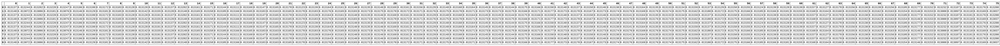

In [83]:
#Matriz S
html_table = df_s.to_html()
with open('output.html', 'w') as f:
  f.write(html_table)
  options = {
          'format': 'png',
          'width': '1000',
          'encoding': 'utf-8'
      }
imgkit.from_file('output.html', 'output.png', options=options)
Image('output.png')

In [84]:
    print("Protótipos de cada grupo g:")
    matriz_g = best_g
    pd.set_option('display.max_columns', 220)
    df_g = pd.DataFrame(matriz_g)
    df_g.style.highlight_max(axis=0, color='green')
    df_g

Protótipos de cada grupo g:


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75
0,-0.418532,-0.223663,-0.416644,0.211648,-0.248875,-0.252941,-0.293625,-0.474506,-0.077787,-0.277978,-0.497268,-0.179421,-0.505598,0.014463,-0.320352,-0.268155,-0.219347,-0.448814,-0.241220,-0.218560,-0.267389,-0.260139,-0.362699,-0.288622,-0.176202,-0.276394,-0.259392,-0.340020,-0.309449,-0.184600,-0.228364,-0.283569,-0.350416,-0.296114,-0.195283,-0.216216,-0.309661,-0.308179,-0.319032,-0.167925,-0.192688,-0.254736,-0.329471,-0.323342,-0.277149,-0.296654,-0.323106,-0.311707,-0.221091,-0.333004,-0.343613,-0.336368,-0.298271,-0.307545,-0.364909,-0.267432,-0.300648,-0.302831,-0.352541,-0.316879,-0.409864,-0.294921,-0.401873,-0.151656,-0.360467,-0.227193,-0.367363,-0.313792,-0.506721,-0.323795,-0.360430,0.266401,-0.444773,0.402785,-0.100843,0.545906
1,0.436096,0.203236,0.401831,-0.181366,0.131095,0.209656,0.211183,0.481205,0.020511,0.174603,0.407479,0.096901,0.453807,-0.075901,0.216540,0.220625,0.126130,0.375320,0.155406,0.144559,0.200295,0.185749,0.256532,0.192566,0.116712,0.219077,0.185585,0.264516,0.204822,0.131467,0.174123,0.190315,0.258980,0.199336,0.154462,0.163128,0.238034,0.219397,0.217523,0.121104,0.151651,0.178111,0.245856,0.223785,0.241063,0.242240,0.262316,0.247890,0.183186,0.272033,0.285961,0.288399,0.260159,0.229896,0.319245,0.222717,0.238629,0.260636,0.325758,0.281052,0.361745,0.236292,0.364874,0.115546,0.296718,0.182478,0.354613,0.296256,0.412174,0.310099,0.379276,-0.245751,0.438900,-0.323387,0.098810,-0.465189
2,-0.418532,-0.223663,-0.416644,0.211648,-0.248875,-0.252941,-0.293625,-0.474506,-0.077787,-0.277978,-0.497268,-0.179421,-0.505598,0.014463,-0.320352,-0.268155,-0.219347,-0.448814,-0.241220,-0.218560,-0.267389,-0.260139,-0.362699,-0.288622,-0.176202,-0.276394,-0.259392,-0.340020,-0.309449,-0.184600,-0.228364,-0.283569,-0.350416,-0.296114,-0.195283,-0.216216,-0.309661,-0.308179,-0.319032,-0.167925,-0.192688,-0.254736,-0.329471,-0.323342,-0.277149,-0.296654,-0.323106,-0.311707,-0.221091,-0.333004,-0.343613,-0.336368,-0.298271,-0.307545,-0.364909,-0.267432,-0.300648,-0.302831,-0.352541,-0.316879,-0.409864,-0.294921,-0.401873,-0.151656,-0.360467,-0.227193,-0.367363,-0.313792,-0.506721,-0.323795,-0.360430,0.266401,-0.444773,0.402785,-0.100843,0.545906
3,0.436096,0.203236,0.401831,-0.181366,0.131095,0.209656,0.211183,0.481205,0.020511,0.174603,0.407479,0.096901,0.453807,-0.075901,0.216540,0.220625,0.126130,0.375320,0.155406,0.144559,0.200295,0.185749,0.256532,0.192566,0.116712,0.219077,0.185585,0.264516,0.204822,0.131467,0.174123,0.190315,0.258980,0.199336,0.154462,0.163128,0.238034,0.219397,0.217523,0.121104,0.151651,0.178111,0.245856,0.223785,0.241063,0.242240,0.262316,0.247890,0.183186,0.272033,0.285961,0.288399,0.260159,0.229896,0.319245,0.222717,0.238629,0.260636,0.325758,0.281052,0.361745,0.236292,0.364874,0.115546,0.296718,0.182478,0.354613,0.296256,0.412174,0.310099,0.379276,-0.245751,0.438900,-0.323387,0.098810,-0.465189
4,-0.418532,-0.223663,-0.416644,0.211648,-0.248875,-0.252941,-0.293625,-0.474506,-0.077787,-0.277978,-0.497268,-0.179421,-0.505598,0.014463,-0.320352,-0.268155,-0.219347,-0.448814,-0.241220,-0.218560,-0.267389,-0.260139,-0.362699,-0.288622,-0.176202,-0.276394,-0.259392,-0.340020,-0.309449,-0.184600,-0.228364,-0.283569,-0.350416,-0.296114,-0.195283,-0.216216,-0.309661,-0.308179,-0.319032,-0.167925,-0.192688,-0.254736,-0.329471,-0.323342,-0.277149,-0.296654,-0.323106,-0.311707,-0.221091,-0.333004,-0.343613,-0.336368,-0.298271,-0.307545,-0.364909,-0.267432,-0.300648,-0.302831,-0.352541,-0.316879,-0.409864,-0.294921,-0.401873,-0.151656,-0.360467,-0.227193,-0.367363,-0.313792,-0.506721,-0.323795,-0.360430,0.266401,-0.444773,0.402785,-0.100843,0.545906
5,-0.418532,-0.223663,-0.416644,0.211648,-0.248875,-0.252941,-0.293625,-0.474506,-0.077787,-0.277978,-0.497268,-0.179421,-0.5055

QStandardPaths: XDG_RUNTIME_DIR not set, defaulting to '/tmp/runtime-root'
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               


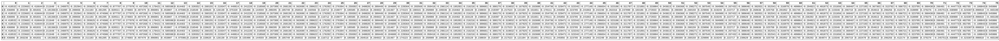

In [85]:
#Matriz G
html_table = df_g.to_html()
with open('output.html', 'w') as f:
  f.write(html_table)
  options = {
          'format': 'png',
          'width': '1000',
          'encoding': 'utf-8'
      }
imgkit.from_file('output.html', 'output.png', options=options)
Image('output.png')